![title](images/header.png)

<br>
<a href="https://www.cosmiqworks.org">
<img src="images/cqw.png" alt="Drawing" style="height: 80px;"/>
<br>
</a>


# Road Network and Speed / Travel Time Prediction from Satellite Imagery
-----
Automated road network extraction from remote sensing imagery remains a significant challenge despite its importance in a broad array of applications. To this end, we explore road network extraction at scale with inference of semantic features of the graph, identifying speed limits and route travel times for each roadway. We call this approach City-Scale Road Extraction from Satellite Imagery (CRESI). See our [github repo](https://github.com/avanetten/cresi) or our [paper](http://openaccess.thecvf.com/content_WACV_2020/papers/Van_Etten_City-Scale_Road_Extraction_from_Satellite_Imagery_v2_Road_Speeds_and_WACV_2020_paper.pdf) for further details on CRESI.

Including estimates for travel time permits true optimal routing (rather than just the shortest geographic distance), which is not possible with existing remote sensing imagery based methods.  Such time-based routing is usually critical to most use cases, and can differ significantly from simple geometric routing (see figure below).

![title](images/routes.png)


This notebook details the steps required to road road networks starting from raw satellite imagery on a local laptop (no GPU server required).  We also explore optimized routing techniques that apply these techniques to an example evacuation scenario in a previously unseen city.

-----
## 1. Prepare your environment



In [1]:
import os

# choose the desired install directory
cresi_dir = '/Users/avanetten/cosmiq/git/cresi/'

### A. Install Docker

CRESI runs inside [Docker](https://www.docker.com/get-started), so to get started ensure docker is installed and running on your machine. After installation, open Docker settings and ensure that available memory is at least 12 GB and 4 cores are available. Run the commands below in a terminal on your local machine.

### B. Create the CRESI Docker Container

#### B.1 Download CRESI from github

Pull down the code to the destination of your choosing (e.g. ```cresi_dir``` above):

In [2]:
!git clone -b dev https://github.com/CosmiQ/cresi.git {cresi_dir}

#### B.2 Build the docker image

Execute the following command, which will take a few minutes:

In [3]:
cresi_docker_dir = os.path.join(cresi_dir, 'docker/cpu')

# Build the docker image
!docker build -t cresi {cresi_docker_dir}

#### B.3. Create the docker container

 Ideally, we would like to access the docke rimage from this notebook, which requires opening a new terminal on your local machine. Entering the command below in a terminal will create a docker container named "cresi_cpu." You can mount important directories with the -v option, and open ports with the -p option:

```
docker run -it -v /Users/avanetten/cosmiq/git/cresi/:/Users/avanetten/cosmiq/git/cresi/ -p 9111:9111 --ipc=host --name cresi_cpu cresi
```

#### B.4. Attach the container

If the "cresi_cpu" container is not already attached, from the terminal enter:

```
docker attach cresi_cpu
```

We now fire up a jupyter notebook in the docker container by executing the following in the docker terminal: 
```
cd /Users/avanetten/cosmiq/git/cresi/notebooks/dar_tutorial_cpu/
jupyter notebook --ip 0.0.0.0 --port=9111 --no-browser --allow-root &
```

You will see something like the following: 
```
[I 17:20:45.043 NotebookApp] Serving notebooks from local directory: /Users/avanetten/cosmiq/git/cresi/notebooks/dar_tutorial_cpu/
[I 17:20:45.043 NotebookApp] The Jupyter Notebook is running at:
[I 17:20:45.043 NotebookApp] http://87w17fc2d3f5:9111/?token=XXXXYYYY
```

Copy the token value (e.g. `XXXXYYYY`). To access the notebook, open a web browser on your local and simply visit:
```
http://localhost:9111/notebooks/cresi_cpu.ipynb
```

Enter the token (e.g. `XXXXYYYY` above) to login.

You are now accessing this notebook using the python kernel from within the docker container, and can run CRESI commands. 

__For the remainder of this tutorial, we assume that this notebook has been restarted and is using the docker kernel.__

In [4]:
# import packages within the docker kernel
import os
import skimage.io
import osmnx as ox
import numpy as np
import pandas as pd
import scipy.spatial
import networkx as nx
import matplotlib.pyplot as plt

cresi_dir = '/Users/avanetten/cosmiq/git/cresi/'
weight_dir = os.path.join(cresi_dir, 'results/aws_weights')
test_im_raw_dir = os.path.join(cresi_dir, 'test_imagery/dar/PS-MS')
test_im_clip_dir = os.path.join(cresi_dir, 'test_imagery/dar/PS-MS_clip')
test_final_dir = os.path.join(cresi_dir, 'test_imagery/dar/PS-RGB_8bit_clip')
results_dir = os.path.join(cresi_dir, 'results/dar_tutorial_cpu')
mask_pred_dir = os.path.join(results_dir, 'folds')
mask_stitched_dir = os.path.join(results_dir, 'stitched/mask_norm')

# make dirs
for d in [weight_dir, test_im_raw_dir, test_im_clip_dir, test_final_dir]:
    os.makedirs(d, exist_ok=True)

-----
## 2. Download Data

### A. Model Weights

CRESI provided the algorithmic baseline for the [SpaceNet 5 Challenge](https://spacenet.ai/sn5-challenge/).  While challenge participants managed to improve the perforamnce of the CRESI baseline by about 5%, we will use the original CRESI model for this exercise, as it has by far the fastest runtime (see [this blog](https://medium.com/the-downlinq/spacenet-5-winning-model-release-end-of-the-road-fd02e00b826c) for further details.) Model weights are freely available on AWS.  The [AWS CLI](https://aws.amazon.com/cli/) tool is installed within the docker container, so you once you configure this tool (via ```aws configure```), simply execute:

In [5]:
!aws s3 cp --recursive s3://spacenet-dataset/spacenet-model-weights/spacenet-5/baseline/ {weight_dir}

### B. Testing Data

Since the pre-trained model weights are available, we need not download the SpaceNet training data.  Instead, we will just download the testing data.  For this exercise, we'll explore SpaceNet Area of Interest (AOI) \#10: Dar Es Salaam.  This city was withheld for testing purposes in SpaceNet 5, meaning that the pre-trained model has not been trained on this city whatsoever.  To download the data (25 GB):

In [6]:
!aws s3 cp --recursive s3://spacenet-dataset/AOIs/AOI_10_Dar_Es_Salaam/PS-MS/ {test_im_raw_dir}

-----
## 3. Prepare Test Data

While CRESI is designed to handle images of arbitrary size and extent, for this exercise we will clip the image somewhat to speed processing time and ease visualization. We will also convert the multi-spectral image 

In [7]:
# Clip the image extent
ulx, uly, lrx, lry = 39.25252, -6.7580, 39.28430, -6.7880  # v0
# ulx, uly, lrx, lry = 39.2443, -6.7628, 39.2830, -6.7920  # v1

im_name = [z for z in os.listdir(test_im_raw_dir) if z.endswith('.tif')][0]
print("im_name:", im_name)
test_im_raw = os.path.join(test_im_raw_dir, im_name)
test_im_clip = os.path.join(test_im_clip_dir, im_name.split('.tif')[0] + '_clip.tif')
print("output_file:", test_im_clip)

!gdal_translate -projwin {ulx} {uly} {lrx} {lry} {test_im_raw} {test_im_clip}

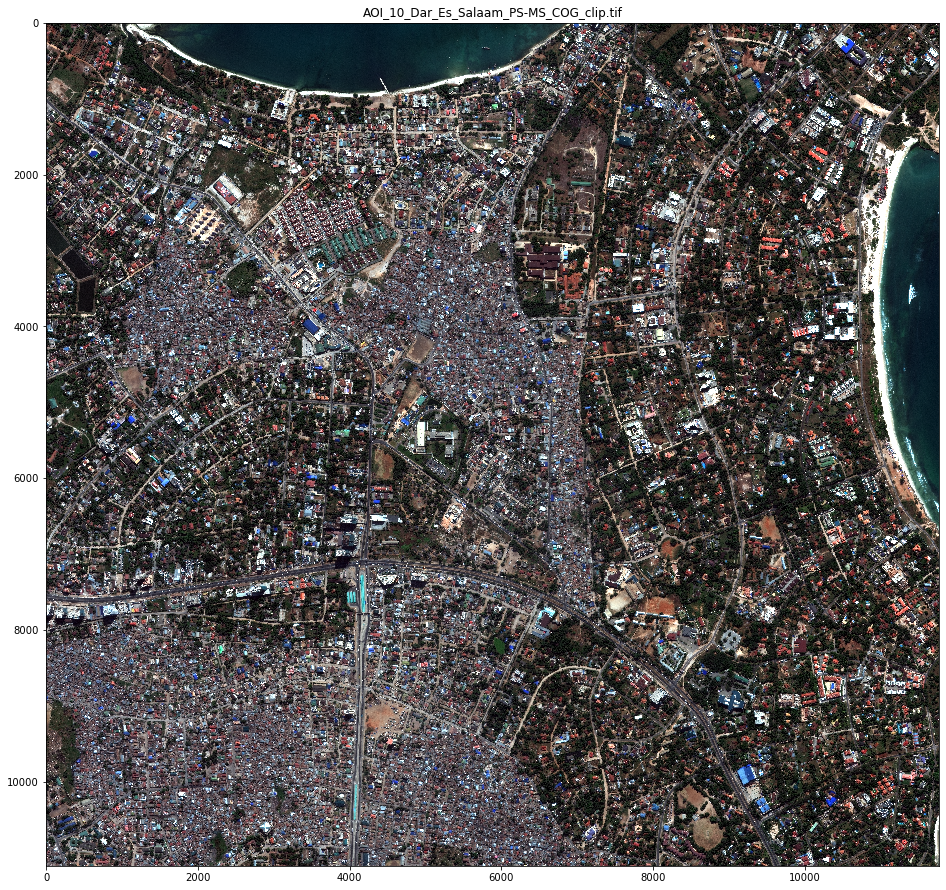

In [12]:
# Convert 16-bit multispectral test data to 8-bit RGB
%cd {os.path.join(cresi_dir, 'cresi/data_prep/')}
import create_8bit_images

create_8bit_images.dir_to_8bit(test_im_clip_dir, test_final_dir,
                              command_file_loc='',
                              rescale_type="perc",
                              percentiles=[2,98],
                              band_order=[5,3,2])

# display our test image
fig_width, fig_height = 16, 16
im_test_name = [z for z in os.listdir(test_final_dir) if z.endswith('.tif')][0]
im_test_path = os.path.join(test_final_dir, im_test_name)
im_test = skimage.io.imread(im_test_path)

fig, ax = plt.subplots(figsize=(fig_width, fig_height))
_ = ax.imshow(im_test)
_ = ax.set_title(im_test_name)

Image stats for AOI_10_Dar_Es_Salaam_PS-RGB_COG_clip.tif: 
- Image shape = (11770, 11111, 3) 
- Num pixels = 130,776,470
- Area = 11.7 km2

-----
## 4. Prepare the config file

CRESI reads from a .json configuration file, 
and for a pre-trained model executing inference requires only changing a few paths in the dar_tutorial_cpu.json file.  Namely, the path to the testing imagery and model weights:

```
{
    "path_src": "/Users/avanetten/cosmiq/git/cresi/cresi/",
    "path_results_root": "/Users/avanetten/cosmiq/git/cresi/results",
    "speed_conversion_file": "/Users/avanetten/cosmiq/git/cresi/cresi/configs/speed_conversion_binned7.csv",
    "save_weights_dir": "/Users/avanetten/cosmiq/git/cresi/tutorial/aws_weights/weights/",
    "test_data_refined_dir": "/Users/avanetten/cosmiq/git/cresi/tutorial/test_imagery_clip/8bit_RGB",
    "test_sliced_dir": "/Users/avanetten/cosmiq/git/cresi/tutorial/test_imagery_sliced",
    "test_results_dir": "dar_tutorial_cpu",
    "slice_x": 1300,
    "slice_y": 1300,
    "stride_x": 1280,
    "stride_y": 1280,
    "skeleton_thresh": 0.25,
    "min_subgraph_length_pix": 600,
    "min_spur_length_m": 12,
    ...
    (the remainder of the variables need not be edited)
    ...
}
```

-----
## 5. Run Inference

The simplest option is to sipmly run the test.sh script (e.g. ```./test.sh configs/dar_tutorial_cpu.json```) which will execute all of the inference scipts.  For this exercise, we will instead run the individual commands to view what's going on at each step.

### 5.1. 02_eval.py 

The 02_eval.py script applies the trained deep learning model to our testing imagery.  First, we tile the imagery into manageable sizes (~400 x 400 meters or 1300 x 1300 pixels), since the entire 130 million pixel image will far exceed available memory on non-supercomputers.  On a MacBook Pro inference proceeds at ~14 seconds per tile, and the entire process completes in ~20 minutes for our 12 square kilometer test image.  For reference, running inference on a single Titan X GPU is 20X faster and completes in ~1 minute.

While running, you will see a progress bar something like:
```
 11%|█                 | 10/90 [02:19<18:38, 13.98s/it]

```

We will kick off inference, and while it's running we'll skip to the intermission and dive deeper into why our approach is necessary.

In [8]:
%cd /Users/avanetten/cosmiq/git/cresi/cresi
%run -i 02_eval.py configs/dar_tutorial_cpu.json

-----
## Intermission: OSM / Commercial Products

One question that often gets asked about approaches like CRESI is: doesn't Google Mapp, Apple Maps, or OpenStreetMap (OSM) already do this? It turns out that there are a number of advantages to a computer vision centric approach, as detailed below.

Commercial products like Google/Apple certainly have a lot of value, but these products often rely upon cell phone GPS pings and infrequently updated imagery for determining real-time routing; in a dynamic scenario (e.g.: natural disaster) existing road networks may be out of date, and cell towers may be down.  Furthermore, the underlaying data is proprietary, further complicating use by practitioners.

Open source offerings such as OSM are similarly useful, though also have limitations.  The crowd-sourced nature of OSM means that updates can take significant time to re-map areas.  For example, it took the Humanitarian OpenStreetMap Team (HOT) over [two months](https://wiki.openstreetmap.org/wiki/2017_Hurricanes_Irma_and_Maria) to fully map Puerto Rico after Hurricane Maria in 2017, even with thousands of volunteers.  

Furthermore, OSM road metadata that can be used to optimize routing is often missing, and road centerline label quality is inconsistent.  For example in the image below there are missing roads on the left, and roads that go through buildings on the right.
<img src="images/osm_goofs.jpg" alt="Drawing" style="height: 200px;"/>

The label inconsistency was explored in Table 3 of our [CRESI paper](http://openaccess.thecvf.com/content_WACV_2020/papers/Van_Etten_City-Scale_Road_Extraction_from_Satellite_Imagery_v2_Road_Speeds_and_WACV_2020_paper.pdf), where we noted significantly reduced road inference performance when using OSM labels versus SpaceNet labels.  

As an example of the sparsity of OSM metadata, we pulled the OSM map for a portion of one of our training cities, Shanghai, below, and colored by the 'maxspeed' tag.  The vast majority of roads have no indicated speed limit.

<br>
<img src="images/shanghai_osm_speed.png" alt="Drawing" style="height: 500px;"/>
<br>

The point here is not to cast aspersions at OSM, which is a great resource, but to point out that there is a need for a rapid machine learning algorithm that can extract precise road centerlines and attendant metadata such as safe travel speed.  

CRESI served as the baseline for the [SpaceNet 5 Challenge](https://spacenet.ai/sn5-challenge/), which yielded 5 new open source road network extraction algorithms.  For further analysis of CRESI and lessons learned from SpaceNet 5, we encourage readers to explore the following blogs:

1. [OSM+Google Imagery](https://medium.com/the-downlinq/computer-vision-with-openstreetmap-and-spacenet-a-comparison-cc70353d0ace)
2. [Neighborhood Comparisons](https://medium.com/the-downlinq/spacenet-5-results-deep-dive-part-2-apls-to-apls-2b1fc7307629)
3. [Predictive Features](https://medium.com/the-downlinq/spacenet-5-results-deep-dive-part-3-the-apls-sauce-378ca0666ca9)
4. [SpaceNet 5 Speed / Performance Comparision](https://medium.com/the-downlinq/spacenet-5-winning-model-release-end-of-the-road-fd02e00b826c)


-----
### 5.1. 02_eval.py (continued)

After it completes, 02_eval.py produce a multi-channel road masks for each image tile.  Each channel of this mask corresponds to a unique speed range.  For each of the testing tiles, the predicted mask will look something like the plot below.

mask_pred.shape: (8, 1300, 1300)


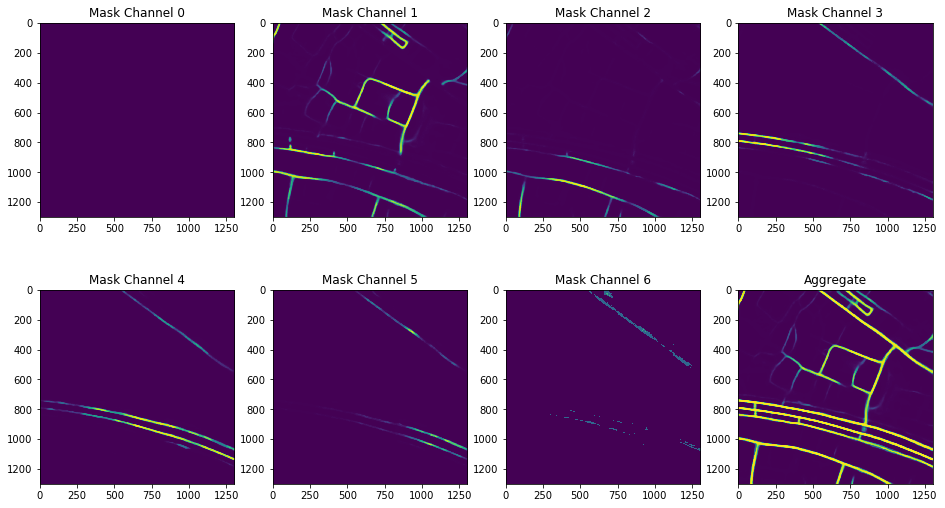

In [67]:
# inspect
mask_pred_file = 'fold0_0__AOI_10_Dar_Es_Salaam_PS-MS_COG_clip__5120__6400__1300__1300__11770__11111.tif'
mask_pred_path = os.path.join(mask_pred_dir, mask_pred_file)
mask_pred = skimage.io.imread(mask_pred_path)
print("mask_pred.shape:", mask_pred.shape)

# # plot only final layer
# fig_width, fig_height = 10, 10
# fig, ax = plt.subplots(figsize=(fig_width, fig_height))
# _ = ax.imshow(mask_pred[-1,:,:])

# plot all layers
fig, axes = plt.subplots(2, 4, figsize=(16, 9))
for i, ax in enumerate(axes.flatten()):
    if i < (len(axes.flatten()) - 1):
        title = 'Mask Channel {}'.format(str(i))
    else:
        title = 'Aggregate' 
    ax.imshow(mask_pred[i,:,:])
    ax.set_title(title)

-----
### 5.2. 03b_stitch.py

The output of 02_eval.py is a series of chipped mask predictions, which we need to stitch back together 
in order to produce the aggregate road network using the procedure illustrated below.  

<br>
<img src="images/basiss_test.jpg" alt="Drawing" style="height: 500px;"/>
<br>

The command below takes ~20 seconds to run for our test image, and creates the total mask. Many road extraction algorithms end here once a road pixel mask has been produced.  We have a few more steps to go, however.

In [16]:
%cd /Users/avanetten/cosmiq/git/cresi/cresi
%run -i 03b_stitch.py configs/dar_tutorial_cpu.json

/Users/avanetten/cosmiq/git/cresi/cresi
Running stitch.py...
post_process_image - w, h: 11770 11111
0 / 90
50 / 90
Compute overlay count mask...
Compute normalized mask...
  row 0 / 11111
  row 1000 / 11111
  row 2000 / 11111
  row 3000 / 11111
  row 4000 / 11111
  row 5000 / 11111
  row 6000 / 11111
  row 7000 / 11111
  row 8000 / 11111
  row 9000 / 11111
  row 10000 / 11111
  row 11000 / 11111
mask_norm.dtype: uint8
mask_raw.dtype: uint16
overlay_count.dtype: uint8
np.max(overlay_count): 4
np.min(overlay_count): 1
Saving to files...
mask_norm.shape: (8, 11111, 11770)
mask_norm.dtype: uint8
Time to run stitch.py and create large masks (and save): 21.20613956451416 seconds


mask_pred.shape: (8, 11111, 11770)


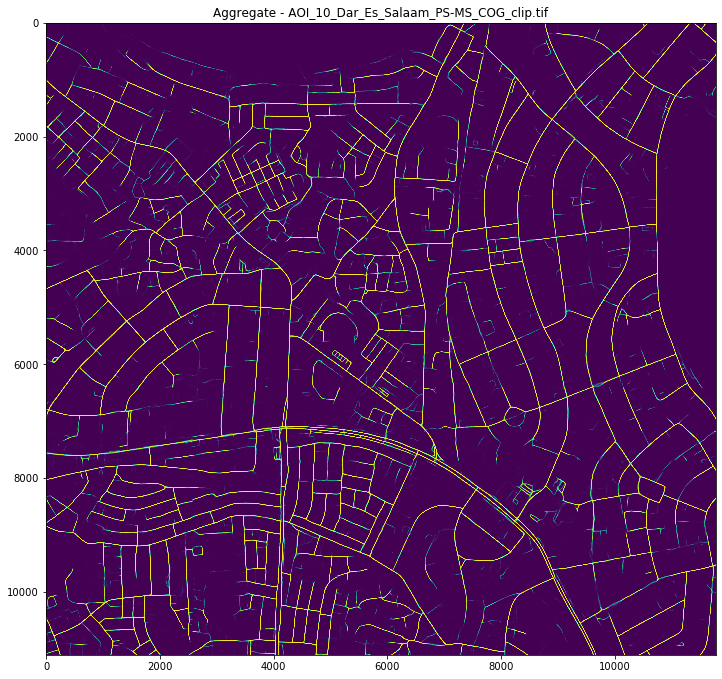

In [5]:
# Inspect the output
mask_pred_file = [z for z in os.listdir(mask_stitched_dir) if z.endswith('.tif')][0]
mask_pred_path = os.path.join(mask_stitched_dir, mask_pred_file)
mask_pred = skimage.io.imread(mask_pred_path)
print("mask_pred.shape:", mask_pred.shape)

# plot final layer
fig_width, fig_height = 12, 12
fig, ax = plt.subplots(figsize=(fig_width, fig_height))
_ = ax.imshow(mask_pred[-1,:,:])
_ = ax.set_title('Aggregate - ' + mask_pred_file)

# # plot all layers
# fig, axes = plt.subplots(2, 4, figsize=(20, 11))
# for i, ax in enumerate(axes.flatten()):
#     if i < (len(axes.flatten()) - 1):
#         title = 'Mask Channel {}'.format(str(i))
#     else:
#         title = 'Aggregate' 
#     ax.imshow(mask_pred[i,:,:])
#     ax.set_title(title)

-----
### 5.3. 04_skeletonize.py

The 04_skeletonize script creates a graph from the aggregate mask via a multi-step process:
    
1. Refine aggregate mask via smoothing, openings, and closings.

2. Extract a skeleton of the refined mask.

3. Build a graph from the skeleton.  Steps 1-3 are summarized in the figure below:

<br>
<img src="images/skeletonize.png" alt="Drawing" style="height: 180px;"/>
<br>

4. Clean out spurious edges and complete missing connections.

5. Output a csv of graph edges.  This csv output is included as a convenient intermediate step, since if speeds and geographic coordinates are not required we can forego Sections 5.4 and 5.5.

The 04_skeletonize.py script is multi-threaded to improve speed, should take ~30 seconds to run.

In [34]:
%run -i 04_skeletonize.py configs/dar_tutorial_cpu.json

min_spur_length_pix: 40
Use_medial_axis? False
im_dir: /Users/avanetten/cosmiq/git/cresi/results/dar_tutorial_cpu/stitched/mask_norm
out_ske_dir: /Users/avanetten/cosmiq/git/cresi/results/dar_tutorial_cpu/skeleton
out_gdir: /Users/avanetten/cosmiq/git/cresi/results/dar_tutorial_cpu/sknw_gpickle

 1 / 1 : AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
  img_loc: /Users/avanetten/cosmiq/git/cresi/results/dar_tutorial_cpu/stitched/mask_norm/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
  im_root: AOI_10_Dar_Es_Salaam_PS-MS_COG_clip
  out_ske_file: /Users/avanetten/cosmiq/git/cresi/results/dar_tutorial_cpu/skeleton/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
Executing make_skeleton...
make_skeleton(), input img_shape: ()
make_skeleton(), img.shape: (11111, 11770)
make_skeleton(), img.size: 130776470
make_skeleton(), img dtype: uint8
Run preprocess()...
Time to run preprocess(): 21.557629585266113 seconds
skeletonize...
Time to run skimage.skeletonize(): 7.691004037857056 seconds
fix_borders...
Time fix bor

In [35]:
# inspect the output
csv_path = os.path.join(results_dir, 'wkt_submission_nospeed.csv')
df = pd.read_csv(csv_path)
df.head()

,ImageId,WKT_Pix
0,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (7350.0 2.0, 7322.0 53.0, 7290.0 12..."
1,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (7568.0 2.0, 7558.0 16.0, 7356.0 17..."
2,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (7787.0 2.0, 7771.0 174.0, 7733.0 3..."
3,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (8759.0 2.0, 8800.0 177.0, 8835.0 2..."
4,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (10481.0 2.0, 10496.0 29.0, 10510.0..."


-----
### 5.4. 05_wkt_to_G.py

This script reads the csv output by 04_skeletonize.py back into graph format (which is very quick), and then uses the metadata encoded in our geotiff test image to assign geographic coordinates to the graph.  Assigning geo-coordinates for thousands of nodes is a computationally intensive process, so this script is multi-threaded to improve performance. The script outputs a [NetworkX](https://networkx.github.io) graph structure in ~60 seconds.

In [36]:
%run -i 05_wkt_to_G.py configs/dar_tutorial_cpu.json

image_ids: ['AOI_10_Dar_Es_Salaam_PS-MS_COG_clip']
len image_ids: 1
image_file: /Users/avanetten/cosmiq/git/cresi/test_imagery/dar/PS-RGB_8bit_clip/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
  wkt_list[:2] ['LINESTRING (7350.0 2.0, 7322.0 53.0, 7290.0 128.0, 7283.0 135.0)'
 'LINESTRING (7568.0 2.0, 7558.0 16.0, 7356.0 171.0)']
im_file: /Users/avanetten/cosmiq/git/cresi/test_imagery/dar/PS-RGB_8bit_clip/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
Running wkt_list_to_nodes_edges()...
Time to run wkt_list_to_nodes_egdes(): 0.5809564590454102 seconds
Creating G...
  len(G.nodes(): 7490
  len(G.edges(): 7507
Time to run nodes_edges_to_G(): 0.5939412117004395 seconds
Clean out short subgraphs
Running clean_sub_graphs...
  sub_graph node count: [6316, 37, 14, 2, 3, 3, 12, 13, 6, 3, 2, 4, 5, 3, 3, 13, 8, 5, 2, 5, 5, 4, 3, 2, 9, 3, 4, 4, 3, 12, 4, 4, 4, 3, 4, 2, 4, 2, 10, 6, 2, 2, 4, 5, 5, 2, 3, 5, 8, 6, 2, 3, 3, 2, 3, 50, 4, 2, 3, 10, 3, 4, 3, 3, 4, 3, 12, 15, 3, 9, 8, 3, 5, 6, 2, 3, 3, 5, 2, 2, 5, 3

   attr_dict_final: {'start': 16533, 'start_loc_pix': (5112.0, 9741.0), 'end': 16534, 'end_loc_pix': (5061.0, 9767.0), 'length_pix': 57.245087125446844, 'wkt_pix': 'LINESTRING (5112 9741, 5061 9767)', 'geometry_pix': <shapely.geometry.linestring.LineString object at 0x7f59d24ece80>, 'osmid': 1662, 'geometry_latlon_wkt': 'LINESTRING (39.26632139998105 -6.784298100003241, 39.26618369998108 -6.784368300003247)', 'geometry_utm_wkt': 'LINESTRING (529428.8763151575 9250088.043657849, 529413.6559119648 9250080.291632272)', 'length_latlon': 0.00015456173520639026, 'length_utm': 17.080824742485973, 'length': 17.080824742485973, 'utm_zone': 37, 'utm_letter': 'M'}
Time to run get_edge_geo_coords(): 27.555500507354736 seconds
pre projection...
17487 random node props: {'osmid': 17487, 'x_pix': 6408.0, 'y_pix': 11108.0, 'lon': 39.26982059998004, 'lat': -6.787989000003541, 'utm_east': 529815.3183971123, 'utm_zone': 37, 'utm_letter': 'M', 'utm_north': 9249679.812962065, 'x': 39.26982059998004, 'y': -

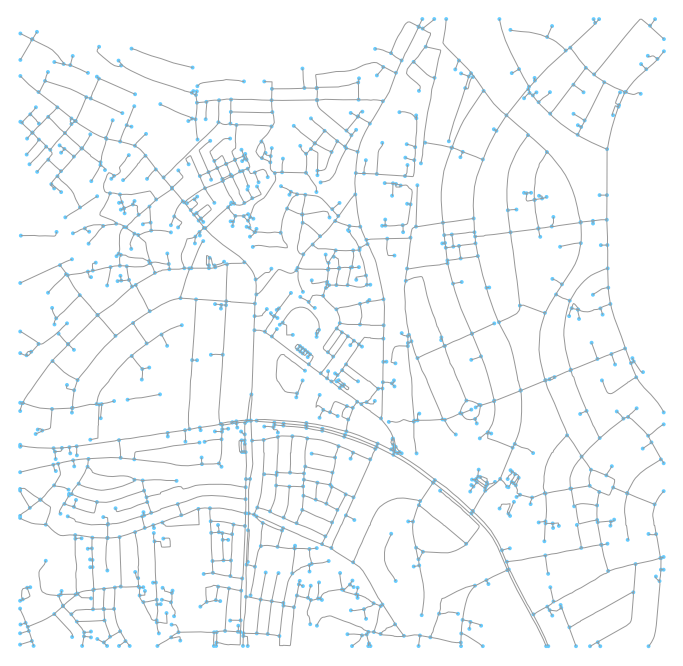

In [40]:
# inspect the output
gpickle = os.path.join(results_dir, 'graphs/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.gpickle')
G0 = nx.read_gpickle(gpickle)
_, _ = ox.plot_graph(G0, fig_height=12, fig_width=12)

-----
### 5.5. 06_infer_speed.py

We can use the multi-channel prediction masks, in combination with the graph created from the previous steps, to infer road speed and travel time. 

The speed inference script is rapid (~10 seconds for this test case), and process executed by the script is summarized below.

<br>
<img src="images/speed_fig.jpg" alt="Drawing" style="height: 500px;"/> 
Speed estimation procedure: Left: Sample multi-class prediction mask; the speed (r) of an individual patch (red square) can be inferred by measuring the signal from each channel. Right: Computed road graph; travel time (∆t) is given by speed (r) and segment length (∆l).



In [39]:
%run -i 06_infer_speed.py configs/dar_tutorial_cpu.json

im_root: AOI_10_Dar_Es_Salaam_PS-MS_COG_clip
Time to infer speed: 11.31566309928894 seconds
Total time: 11.400012969970703 seconds


-----
# Results

With the graph now completed, we can make a few more plots.  In this case we'll color by inferred road speed, with speed increasing from yellow (15 mph) to red (65 mph).

/Users/avanetten/cosmiq/git/cresi/cresi


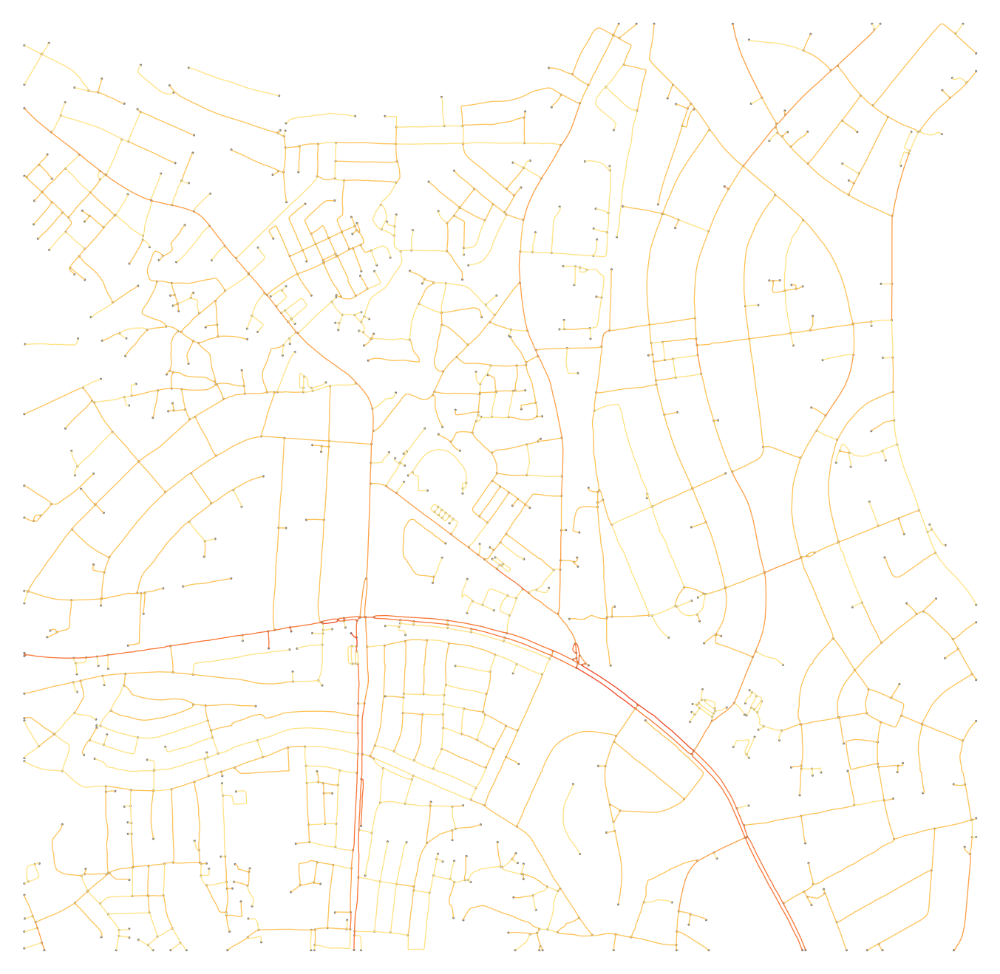

In [55]:
# Plot output graph, colored by speed
%cd /Users/avanetten/cosmiq/git/cresi/cresi
plot_graph_plus_im = __import__('08_plot_graph_plus_im')
import importlib
importlib.reload(plot_graph_plus_im)

# data
im_test = [z for z in os.listdir(test_final_dir) if z.endswith('.tif')][0]
im_test_path = os.path.join(test_final_dir, im_test)
im_test = skimage.io.imread(im_test_path).astype(np.uint8)

graph_pkl = os.path.join(results_dir, 'graphs_speed/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.gpickle')
G = nx.read_gpickle(graph_pkl)

# plot settings
fig_height=24
fig_width=24
node_color='gray'   
edge_color='#bfefff'   # lightblue
node_size=10
node_alpha=1
edge_color_key = 'inferred_speed_mph'
edge_linewidth=1.3
edge_alpha=1
route_color='blue'
orig_dest_node_color=('green', 'red')
orig_dest_node_alpha=0.8
route_linewidth=5*edge_linewidth
orig_dest_node_size=400
invert_yaxis = True
dpi=500

# # print an edge
# edge_tmp = list(G.edges())[-1]
# print (edge_tmp, "random edge props:", G.edges([edge_tmp[0], edge_tmp[1]])) #G.edge[edge_tmp[0]][edge_tmp[1]])

# plot
color_dict, color_list = plot_graph_plus_im.make_color_dict_list()
_ = plot_graph_plus_im.plot_graph_pix(G, im=None, fig_height=fig_height, fig_width=fig_width, 
                           node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                           edge_linewidth=edge_linewidth, edge_alpha=edge_alpha,
                           edge_color_key=edge_color_key, color_dict=color_dict,
                           invert_yaxis=invert_yaxis, 
                           default_dpi=dpi,
                           show=True, save=False)

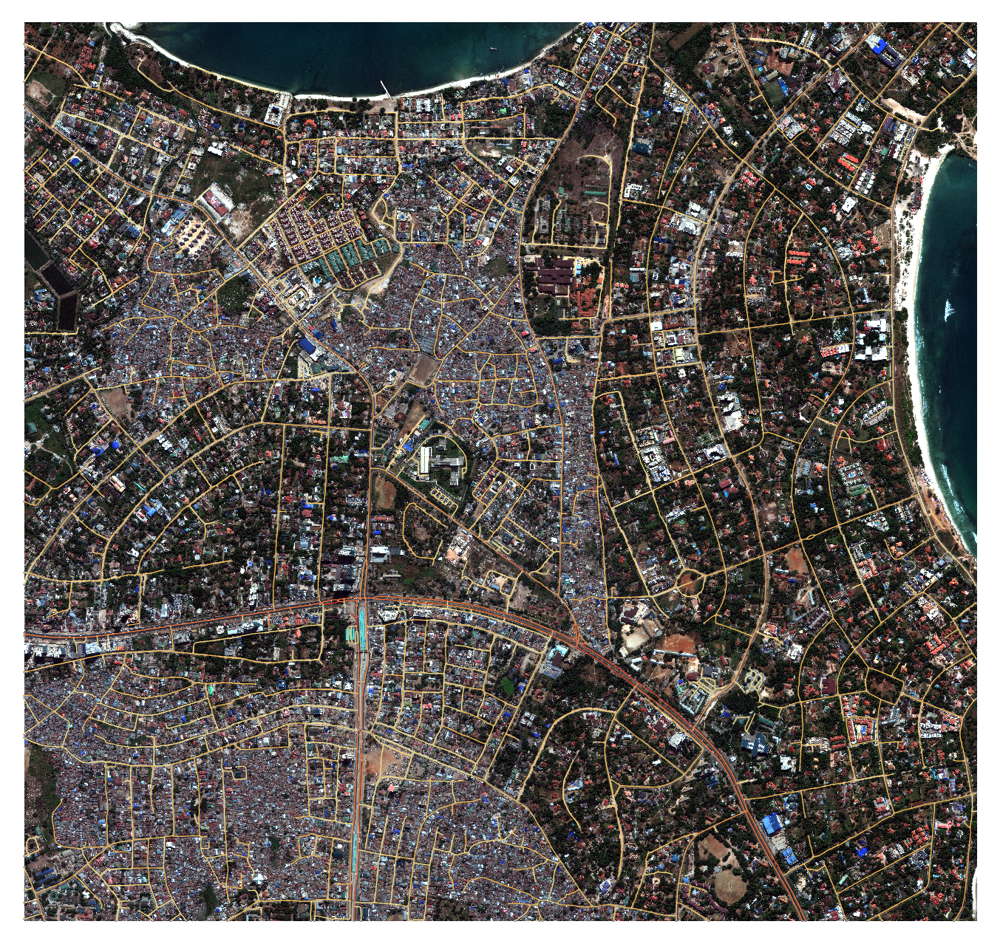

In [52]:
# We can also plot the graph with the image in the background
_ = plot_graph_plus_im.plot_graph_pix(G, im=im_test, fig_height=fig_height, fig_width=fig_width, 
                           node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                           edge_linewidth=edge_linewidth, edge_alpha=edge_alpha,
                           edge_color_key=edge_color_key, color_dict=color_dict,
                           invert_yaxis=invert_yaxis, 
                           default_dpi=dpi,
                           show=True, save=False)

-----
## 6. Routes

We can use our final road network to compute optimal routes between nodes of interest. First let's collect the node coordinates into a [kd-tree](https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.KDTree.html#scipy.spatial.KDTree) for quick nearest neighbor lookup:

In [58]:
# Get lat-lon positions of all the inferred nodes, read into a kd-tree
all_nodes = list(G.nodes())
print("N nodes:", len(all_nodes))
node_coords = np.array([[G.node[t]['lat'], G.node[t]['lon']] for t in all_nodes])
kdtree_nodes = scipy.spatial.KDTree(node_coords)
print("kdtree_nodes.data[:5]:", kdtree_nodes.data[:5])

N nodes: 1314
kdtree_nodes.data[:5]: [[-6.7580028 39.272364 ]
 [-6.7583619 39.2721831]
 [-6.7580028 39.2729526]
 [-6.7584591 39.2723802]
 [-6.7580028 39.2735439]]


Recall that our test image extends from (lat, lon) = (-6.7580, 39.25252,) to (lat, lon) = (-6.7880, 39.28430).  Let us assume a situation where we have a known asset position, and we want to evacuate to the northeast.  Let us explore this scenario:

In [59]:
asset_pos = [-6.78344, 39.26536]    # position of asset
evac_pos = [-6.758, 39.2843]        # northeast corner 

# get nodes nearest positions
n_asset = all_nodes[kdtree_nodes.query(asset_pos)[1]]
n_evac = all_nodes[kdtree_nodes.query(evac_pos)[1]]
print("start node, end node:", n_asset, n_evac)

# let's get the shortest path by distance:
weight0 = 'length'
print("\nWeight:", weight0)
length_m0, path0 = nx.single_source_dijkstra(G, source=n_asset, target=n_evac, weight=weight)
length_km0 = length_m0 / 1000
print("path0:", path0)
print("Length0 (km):", length_km0)
# also compute time:
tt0 = sum([G[path[i]][path[i+1]][0]['Travel Time (h)'] for i in range(len(path0)-1)])
print("Travel Time (h)", tt)

# Now let's weight by speed
weight1 = 'Travel Time (h)'
print("\nWeight:", weight1)
tt1, path1 = nx.single_source_dijkstra(G, source=n_asset, target=n_evac, weight=weight1)
print("path1:", path1)
length_km1 = sum([G[path[i]][path[i+1]][0]['length'] for i in range(len(path1)-1)])/1000
print("Length1 (km):", length_km1)
print("Travel Time (h)", tt1)

start node, end node: 16193 10024

Weight: length
path0: [16193, 16151, 15971, 16173, 16052, 15877, 15647, 15493, 15148, 15027, 14769, 14725, 14685, 14894, 14920, 14819, 14792, 14574, 14190, 14148, 13934, 13624, 13487, 13160, 12538, 12485, 12245, 12468, 12239, 11744, 11531, 11434, 11016, 10851, 10552, 10520, 10340, 10200, 10100, 10031, 10166, 10041, 10032, 10024]
Length0 (km): 4.6395324126357425
Travel Time (h) 0.10877731540417628

Weight: Travel Time (h)
path1: [16193, 16151, 15977, 15946, 15842, 15342, 14918, 14509, 14493, 14238, 13524, 13407, 13202, 13166, 12888, 12814, 12618, 12418, 12428, 12549, 12583, 12579, 12423, 12485, 12245, 12468, 12239, 11744, 11531, 11434, 11016, 10851, 10552, 10520, 10340, 10200, 10100, 10031, 10166, 10041, 10032, 10024]
Length1 (km): 4.144947763451344
Travel Time (h) 0.10604742062754784


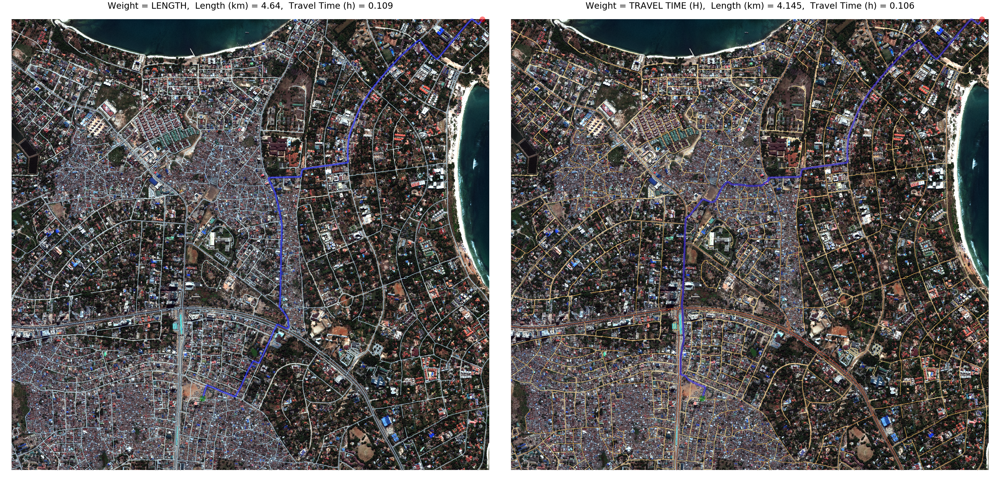

In [57]:
# Make plots...

rowplot = True
if rowplot:
    fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(2*fig_width, fig_height))  # side by side (easier to compare)
else:
    fig, (ax0, ax1) = plt.subplots(nrows=2, figsize=(fig_width, 2.1*fig_height))  # vertically aligned (larger)

# plot length
fout = os.path.join(results_dir, 'plots/route0_length.png')  # saving is slow...
fig, ax0 = plot_graph_plus_im.plot_graph_route_pix(G, path0, im=im_test, fig_height=fig_height, fig_width=fig_width, 
                      node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                      edge_linewidth=edge_linewidth, edge_alpha=edge_alpha, edge_color=edge_color,
                      orig_dest_node_size=orig_dest_node_size,
                      route_color=route_color, 
                      orig_dest_node_color=orig_dest_node_color,
                      route_linewidth=route_linewidth,
                      invert_yaxis=invert_yaxis, 
                      default_dpi=dpi,                        
                      show=False, close=False,
                      edge_color_key=None, color_dict=None,
                      save=False, filename=fout,
                      fig=fig, ax=ax0)
_ = ax0.set_title("Weight = {},  Length (km) = {},  Travel Time (h) = {}".format(
    weight0.upper(), np.round(length_km0, 3), np.round(tt0, 3)), fontsize=30)

# plot speed
fig, ax1 = plot_graph_plus_im.plot_graph_route_pix(G, path1, im=im_test, fig_height=fig_height, fig_width=fig_width, 
                      node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                      edge_linewidth=edge_linewidth, edge_alpha=edge_alpha, edge_color=edge_color,
                      orig_dest_node_size=orig_dest_node_size,
                      route_color=route_color, 
                      orig_dest_node_color=orig_dest_node_color,
                      route_linewidth=route_linewidth,
                      invert_yaxis=invert_yaxis, 
                      default_dpi=dpi,                        
                      show=False, close=False,
                      edge_color_key=edge_color_key,
                      color_dict=color_dict,
                      save=False, filename=fout,
                      fig=fig, ax=ax1)
_ = ax1.set_title("Weight = {},  Length (km) = {},  Travel Time (h) = {}".format(
    weight1.upper(), np.round(length_km1, 3), np.round(tt1, 3)), fontsize=30)

plt.tight_layout()
plt.show()

In [28]:
# # Singular plot, weighted by speed, saved to results_dir (optional)
# weight = 'Travel Time (h)'
# tt, path = nx.single_source_dijkstra(G, source=n_asset, target=n_evac, weight=weight)
# print("path:", path)
# length_km = sum([G[path[i]][path[i+1]][0]['length'] for i in range(len(path)-1)])/1000
# print("Length (km):", l_km)
# print("Travel Time (h)", tt)

# fout = os.path.join(results_dir, 'plots/route_asset_time.png')  
# fig1, ax1 = plot_graph_plus_im.plot_graph_route_pix(G, path, im=im_test, fig_height=fig_height, fig_width=fig_width, 
#                       node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
#                       edge_linewidth=edge_linewidth, edge_alpha=edge_alpha, edge_color=edge_color,
#                       orig_dest_node_size=orig_dest_node_size,
#                       route_color=route_color, 
#                       orig_dest_node_color=orig_dest_node_color,
#                       route_linewidth=route_linewidth,
#                       invert_yaxis=invert_yaxis, 
#                       default_dpi=dpi,                        
#                       show=False, close=False,
#                       edge_color_key=edge_color_key,
#                       color_dict=color_dict,
#                       save=True, filename=fout)
# _ = ax1.set_title("Weight = {},  Length (km) = {},  Travel Time (h) = {}".format(
#     weight, np.round(length_km,3), np.round(tt,3)), fontsize=20)
# plt.show()

----
Clearly, the optial route is very different when weighting by time rather than distance, underscoring the need to incorporate speed estimates into road graphs.  We encourage the interested reader to explore optimal routes between random nodes in the cell below.  

Start node: 11545, End node: 11801
Weight: Travel Time (h)
Optimal path:
 [16193, 16151, 15977, 15946, 15842, 15342, 14918, 14509, 14493, 14238, 13524, 13407, 13202, 13166, 12888, 12814, 12618, 12418, 12428, 12549, 12583, 12579, 12423, 12485, 12245, 12468, 12239, 11744, 11531, 11434, 11016, 10851, 10552, 10520, 10340, 10200, 10100, 10031, 10166, 10041, 10032, 10024]
Optimal path coordinates:
 [[-6.7656519 39.2624955]
 [-6.7657221 39.2625171]
 [-6.7657518 39.2625144]
 [-6.7661001 39.2616396]
 [-6.7667751 39.2606244]
 [-6.767145  39.2609376]
 [-6.7673583 39.2611023]
 [-6.7676472 39.2613291]
 [-6.7679955 39.2615856]
 [-6.7680063 39.2616585]
 [-6.7696398 39.2635863]
 [-6.7704579 39.2641425]
 [-6.7711761 39.2641776]
 [-6.7700205 39.2661594]
 [-6.7699071 39.2662134]
 [-6.7692564 39.2664969]
 [-6.7687893 39.2669586]
 [-6.7690674 39.2680926]
 [-6.7690674 39.2689566]
 [-6.7690512 39.2692671]
 [-6.7689567 39.2692779]
 [-6.768765  39.269664 ]
 [-6.7685625 39.2696073]
 [-6.7685058 39.2706387]
 [-6

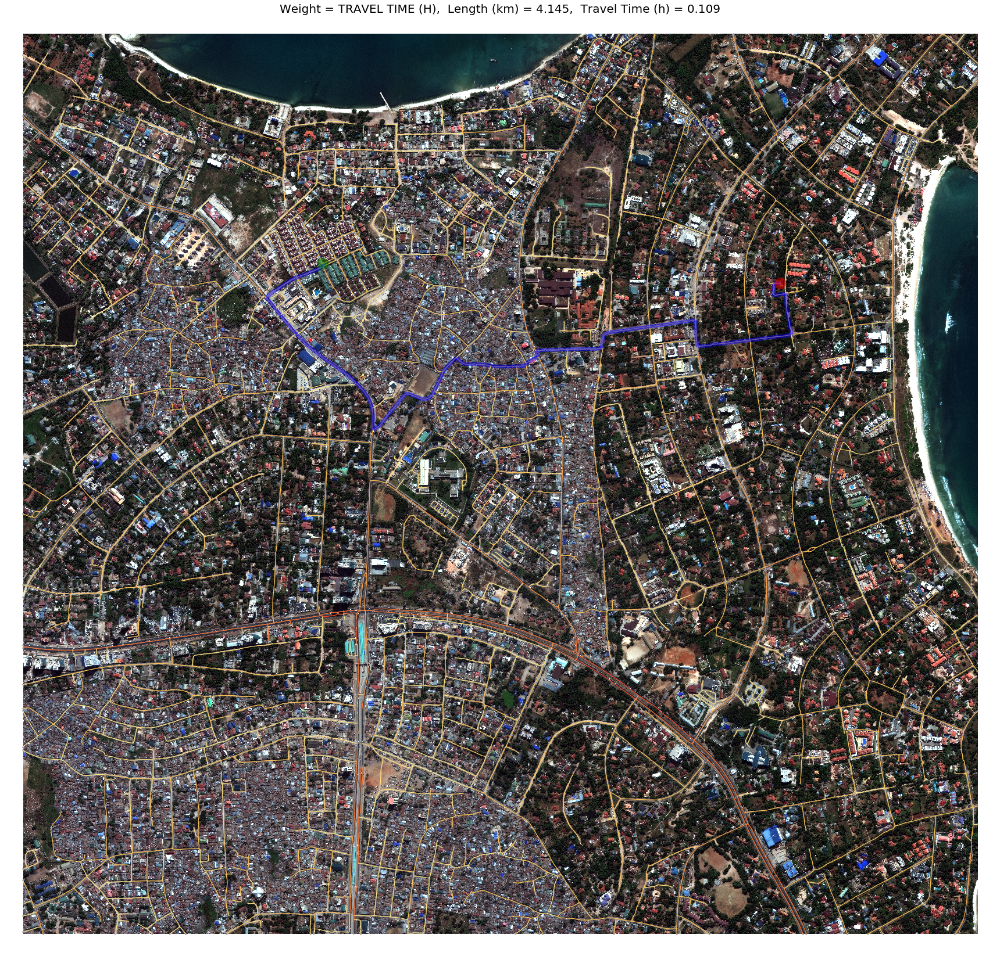

In [66]:
# Plot of optimal route between two random nodes
weight2 = 'Travel Time (h)'  # 'length'

# get random lat, lon start and end positions
lat_vals = np.random.uniform(low=-6.7880, high=-6.7580, size=(2))
lon_vals = np.random.uniform(low=39.25252, high=39.28430, size=(2))
start_pos = [lat_vals[0], lon_vals[0]]
end_pos = [lat_vals[1], lon_vals[1]]

# get nodes nearest positions
n_start = all_nodes[kdtree_nodes.query(start_pos)[1]]
n_end = all_nodes[kdtree_nodes.query(end_pos)[1]]
print("Start node: {}, End node: {}".format(n_start, n_end))

print("Weight:", weight2)
_, path2 = nx.single_source_dijkstra(G, source=n_start, target=n_end, weight=weight2)
path_coords = np.array([[G.node[t]['lat'], G.node[t]['lon']] for t in path2])
print("Optimal path:\n", path1)
print("Optimal path coordinates:\n", path_coords)
length_km2 = sum([G[path[i]][path[i+1]][0]['length'] for i in range(len(path1)-1)])/1000
tt2 = sum([G[path[i]][path[i+1]][0]['Travel Time (h)'] for i in range(len(path0)-1)])
print("Length (km):", length_km2)
print("Travel Time (h)", tt2)

# plot speed
fig2, ax2 = plot_graph_plus_im.plot_graph_route_pix(G, path2, im=im_test, fig_height=fig_height, fig_width=fig_width, 
                      node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                      edge_linewidth=edge_linewidth, edge_alpha=edge_alpha, edge_color=edge_color,
                      orig_dest_node_size=orig_dest_node_size,
                      route_color=route_color, 
                      orig_dest_node_color=orig_dest_node_color,
                      route_linewidth=route_linewidth,
                      invert_yaxis=invert_yaxis, 
                      default_dpi=dpi,                        
                      show=True, close=False,
                      edge_color_key=edge_color_key,
                      color_dict=color_dict,
                      save=False)
_ = ax2.set_title("Weight = {},  Length (km) = {},  Travel Time (h) = {}".format(
    weight2.upper(), np.round(length_km2, 3), np.round(tt2, 3)), fontsize=20)
plt.tight_layout()
plt.show()

----
In this tutorial we have shown how to extract a road network graph with speed / travel time estimates direclty from satellite imagery using only open source data and code.  Inference is relatively rapid, running at ~0.5 square kilometers per minute even on a CPU.  GPU infrence times would be a minimum of 20X faster.  Even for a city unseen during training (Dar Es Salaam), the CRESI algorithm manages to return a road network that is sufficiently connected and complete to be routable.  We showed how to compute optimal routes, and demonstrated the importance of routing using speed versus geometric distance.  We encourage interested parties to continue to explore the intricacies of road network extraction and routing, and to contribute to open source geospatial software if time and interest permits.  